# Loading libraries

In [1]:
library(opera)

# Loading datasets

In [12]:
# French data
data_train <- read.csv("data/train.csv")
data_test1 <- read.csv("data/test1.csv")
data_test2 <- read.csv("data/test2.csv")

# GAM
gam1 <- read.csv("data/experts/gam1_forecast_v2.csv")
gam2 <- read.csv("data/experts/gam2_forecast_v2.csv")
gam1 <- gam1$x
gam2 <- gam2$x

# GAM Saturday
gams1 <- read.csv("data/experts/gams1_forecast_v2.csv")
gams2 <- read.csv("data/experts/gams2_forecast_v2.csv")
gams1 <- gams1$x
gams2 <- gams2$x

# GAM finetuned
gamf1 <- read.csv("data/experts/ft_te1_v2.csv")
gamf2 <- read.csv("data/experts/ft_te2_v2.csv")
gamf1 <- gamf1$ft_te1
gamf2 <- gamf2$ft_te2

# GAM delta
gamd1 <- read.csv("data/experts/delta1_v2.csv")
gamd2 <- read.csv("data/experts/delta2_v2.csv")
gamd1 <- gamd1$delta1
gamd2 <- gamd2$delta2

# GBM
gbm1 <- read.csv("data/experts/gbm1_forecast_v2.csv")
gbm2 <- read.csv("data/experts/gbm2_forecast_v2.csv")
gbm1 <- gbm1$x
gbm2 <- gbm2$x

In [14]:
# Compute MAPE
mape <- function(x, y) {
  mean(abs(x - y)/x)*100
}

print(paste("[GAM] The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gam1), 2), "%", sep = " "))
print(paste("[GAMs] The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gams1), 2), "%", sep = " "))
print(paste("[GBM] The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gbm1), 2), "%", sep = " "))
print(paste("[FT] The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gamf1), 2), "%", sep = " "))
print(paste("[DELTA] The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gamd1), 2), "%", sep = " "))

print(paste("[GAM] The MAPE on the test set 2 is", round(mape(data_test2$Consommation, gam2), 2), "%", sep = " "))
print(paste("[GAMs] The MAPE on the test set 1 is", round(mape(data_test2$Consommation, gams2), 2), "%", sep = " "))
print(paste("[GBM] The MAPE on the test set 2 is", round(mape(data_test2$Consommation, gbm2), 2), "%", sep = " "))
print(paste("[FT] The MAPE on the test set 2 is", round(mape(data_test2$Consommation, gamf2), 2), "%", sep = " "))
print(paste("[DELTA] The MAPE on the test set 2 is", round(mape(data_test2$Consommation, gamd2), 2), "%", sep = " "))

[1] "[GAM] The MAPE on the test set 1 is 5.4 %"
[1] "[GAMs] The MAPE on the test set 1 is 4.02 %"
[1] "[GBM] The MAPE on the test set 1 is 6.34 %"
[1] "[FT] The MAPE on the test set 1 is 3.96 %"
[1] "[DELTA] The MAPE on the test set 1 is 24.15 %"
[1] "[GAM] The MAPE on the test set 2 is 3.77 %"
[1] "[GAMs] The MAPE on the test set 1 is 5.78 %"
[1] "[GBM] The MAPE on the test set 2 is 5.04 %"
[1] "[FT] The MAPE on the test set 2 is 3.78 %"
[1] "[DELTA] The MAPE on the test set 2 is 6.45 %"


In [15]:
Y1 <- data_test1$Consommation
X1 <- cbind(gam1, gams1, gbm1, gamf1, gamd1)

Y2 <- data_test2$Consommation
X2 <- cbind(gam2, gams2, gbm2, gamf2, gamd2)

In [16]:
oracle.convex <- oracle(Y = Y1, experts = X1, loss.type = "square", model = "convex")
print(oracle.convex)
plot(oracle.convex)

Call:
oracle.default(Y = Y1, experts = X1, model = "convex", loss.type = "square")

Coefficients:
  gam1 gams1  gbm1 gamf1   gamd1
 0.166 0.442 0.016 0.371 0.00548

                      rmse   mape
Best expert oracle:   2420 0.0396
Uniform combination:  2770 0.0434
Best convex oracle:   2130 0.0347


HTML widgets cannot be represented in plain text (need html)

In [17]:
oracle.convex <- oracle(Y = Y2, experts = X2, loss.type = "square", model = "convex")
print(oracle.convex)
plot(oracle.convex)

Call:
oracle.default(Y = Y2, experts = X2, model = "convex", loss.type = "square")

Coefficients:
     gam2 gams2     gbm2 gamf2  gamd2
 4.07e-21 0.194 4.07e-21 0.782 0.0246

                      rmse   mape
Best expert oracle:   2020 0.0378
Uniform combination:  2080 0.0385
Best convex oracle:   1910 0.0347


HTML widgets cannot be represented in plain text (need html)

In [18]:
MLpol0 <- mixture(model = "MLpol", loss.type = "square")

MLpol1 <- MLpol0
for (i in 1:length(Y1)) {
  MLpol1 <- predict(MLpol1, newexperts = X1[i, ], newY = Y1[i])
}

MLpol2 <- MLpol0
for (i in 1:length(Y2)) {
  MLpol2 <- predict(MLpol2, newexperts = X2[i, ], newY = Y2[i])
}

summary(MLpol1)
summary(MLpol2)
plot(MLpol1)
plot(MLpol2)

Aggregation rule: MLpol 
Loss function:  squareloss 
Gradient trick:  TRUE 
Coefficients: 
  gam1 gams1  gbm1 gamf1 gamd1
 0.704 0.175 0.121     0     0

Number of experts:  5
Number of observations:  1488
Dimension of the data:  1 

        rmse   mape
MLpol   1580 0.0263
Uniform 2770 0.0434

Aggregation rule: MLpol 
Loss function:  squareloss 
Gradient trick:  TRUE 
Coefficients: 
  gam2 gams2 gbm2 gamf2 gamd2
 0.305     0 0.25 0.445     0

Number of experts:  5
Number of observations:  2544
Dimension of the data:  1 

        rmse   mape
MLpol   1690 0.0301
Uniform 2080 0.0385

Shiny tags cannot be represented in plain text (need html)

Shiny tags cannot be represented in plain text (need html)

In [19]:
predictions <- MLpol1$prediction
newexperts <- X1[1:3, ] # Experts forecasts to predict 3 new points  
pred <- predict(MLpol1, newexperts = newexperts, online = FALSE, type = 'response')
pred = newexperts %*% MLpol1$coefficients
YBlock1 <- seriesToBlock(X = Y1, d = 4)
XBlock1 <- seriesToBlock(X = X1, d = 4)
MLpolBlock1 <- mixture(Y = YBlock1, experts = XBlock1, model = "MLpol", loss.type = "square")
prediction1 <- blockToSeries(MLpolBlock1$prediction)

In [20]:
predictions <- MLpol2$prediction
newexperts <- X2[1:3, ] # Experts forecasts to predict 3 new points  
pred <- predict(MLpol2, newexperts = newexperts, online = FALSE, type = 'response')
pred = newexperts %*% MLpol2$coefficients
YBlock2 <- seriesToBlock(X = Y2, d = 4)
XBlock2 <- seriesToBlock(X = X2, d = 4)
MLpolBlock2 <- mixture(Y = YBlock2, experts = XBlock2, model = "MLpol", loss.type = "square")
prediction2 <- blockToSeries(MLpolBlock2$prediction)

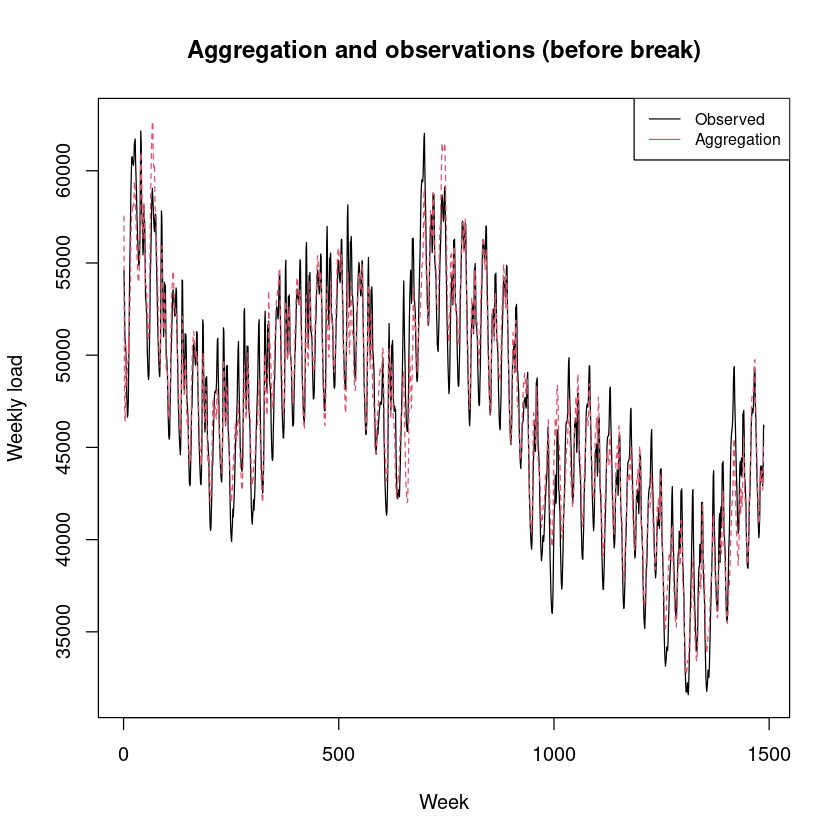

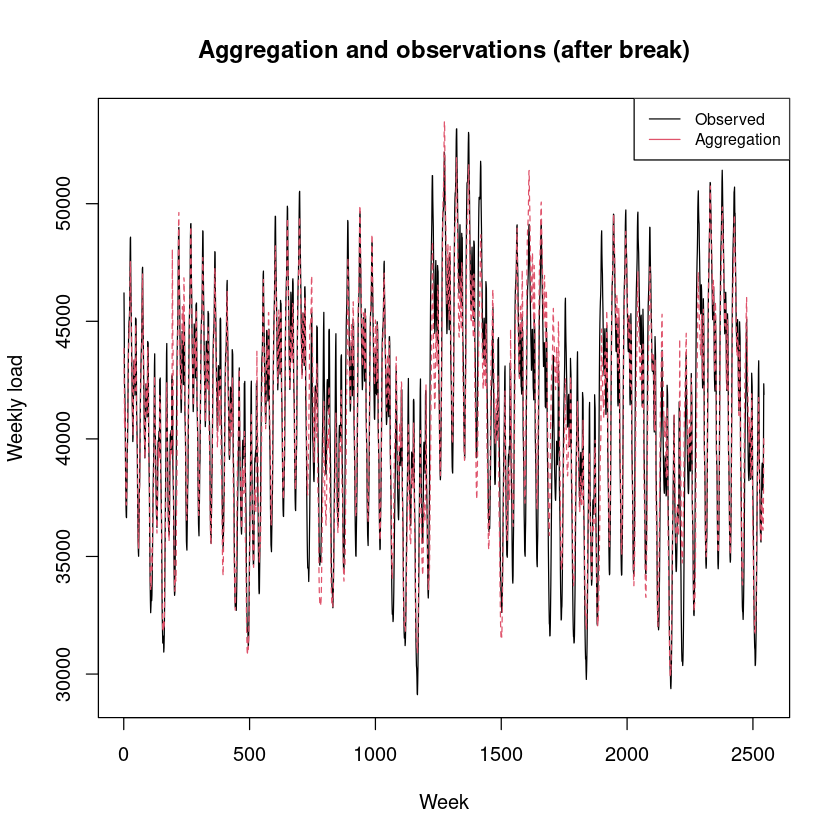

In [21]:
X1_agg <- prediction1
matplot(cbind(Y1, X1_agg), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Aggregation and observations (before break)")
legend("topright", legend = c("Observed", "Aggregation"), col = 1:2, lty = 1, cex = 0.8)

X2_agg <- prediction2
matplot(cbind(Y2, X2_agg), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Aggregation and observations (after break)")
legend("topright", legend = c("Observed", "Aggregation"), col = 1:2, lty = 1, cex = 0.8)

In [22]:
# Convert to dataframe
X1_agg <- as.data.frame(X1_agg)
X2_agg <- as.data.frame(X2_agg)
write.csv(X1_agg, file = "data/experts/X1_agg_v2.csv")
write.csv(X2_agg, file = "data/experts/X2_agg_v2.csv")